# Analiza i modyfikacje zbioru danych

In [1]:
import pandas as pd
import swifter
from pathlib import Path

import plotly.express as px
import plotly.graph_objects as go

import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D

from gensim.models import Word2Vec

import seaborn as sns


# import plotly.io as pio
# pio.renderers.default='notebook'

In [2]:
DATA_DIR = Path("data")
MEMBERS_DATA_PATH = DATA_DIR / "members.tsv"
LABELS_DATA_PATH = DATA_DIR / "labels.tsv"
IMAGES_PATH = Path("images")
EMBBEDDINGS_PATH = Path("embbeddings")

## O zbiorze

Zbiór danych *email-Eu-core* został stworzony z informacji na temat wymiany mailowej głównie między członkami pewnej dużej instytucji badawczej. Dodatkowo pojawiają się maile do ludzi spoza tej instytucji. Zawiera on informację o 
- id nadawcy i odbiorcy, zawartej w pliku `members.tsv`. Pierwsza kolumna to id nadawcy (`from`), a druga to id odbiorcy (`to`)
- przynależności pracownika do działu (departamentu), zawartej w pliku `labels.tsv`. Kolumny to kolejno id pracownika `user_id` i id departamentu `department_id`.

## Wczytanie zbioru

In [3]:
members_df = pd.read_csv(MEMBERS_DATA_PATH, sep=" ", header=None, names=["from", "to"])
members_df

,from,to
0,0,1
1,2,3
2,2,4
3,5,6
4,5,7
...,...,...
25566,420,143
25567,174,859
25568,440,460
25569,52,786


In [4]:
labels_df = pd.read_csv(LABELS_DATA_PATH, sep=" ", header=None, names=["user_id", "department_id"])
labels_df

,user_id,department_id
0,0,1
1,1,1
2,2,21
3,3,21
4,4,21
...,...,...
1000,1000,4
1001,1001,21
1002,1002,1
1003,1003,6


## Analiza zbioru

### Dane z informacją o departamencie

In [5]:
len(labels_df["department_id"].unique())

42

In [6]:
departments_count_df = pd.DataFrame(labels_df["department_id"].value_counts())
departments_count_df.index.name = "col1"
departments_count_df = departments_count_df.reset_index()
departments_count_df = departments_count_df.rename(columns={"department_id": "count", "col1": "department_id"})
departments_count_df = departments_count_df.sort_values(by="count", ascending=False)
departments_count_df.head()

,department_id,count
0,4,109
1,14,92
2,1,65
3,21,61
4,15,55


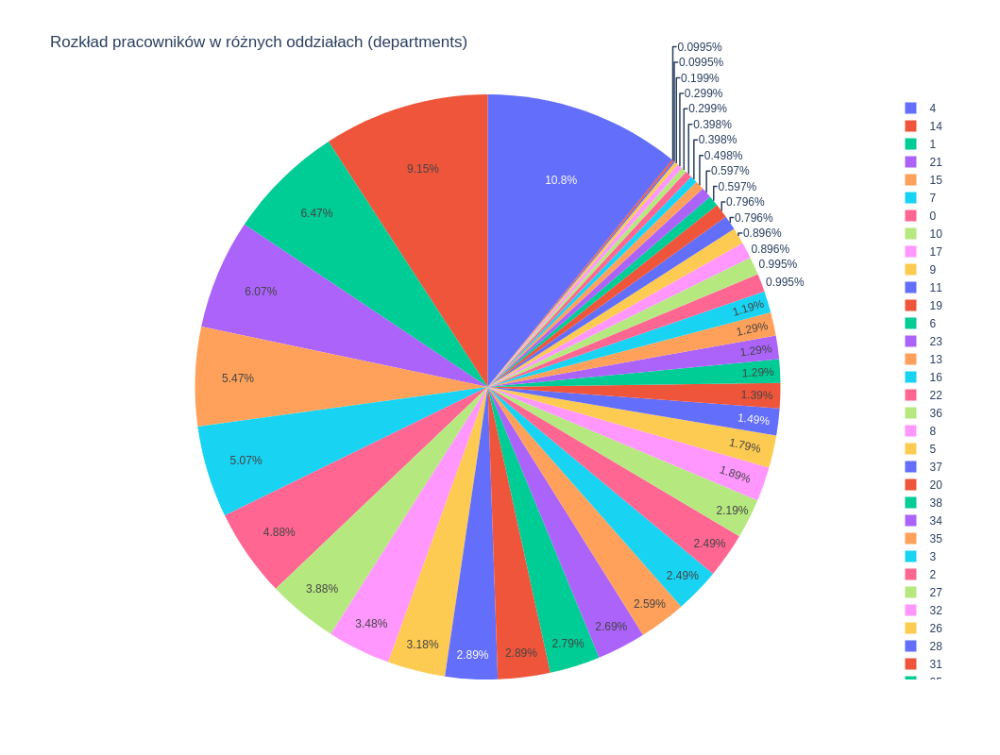

In [7]:
fig = px.pie(
    departments_count_df,
    values="count",
    names="department_id",
    color="department_id",
    width=800,
    height=800,
    title='Rozkład pracowników w różnych oddziałach (departments)',
)
fig 

In [8]:
small_departments = departments_count_df[departments_count_df['count'] < 10]
small_departments

,department_id,count
28,32,9
29,26,9
30,28,8
31,31,8
33,25,6
32,24,6
34,29,5
35,30,4
36,40,4
37,12,3


W zbiorze znajduje się sporo działów, do których należy bardzo mała liczba osób. Do działu o id `18` i id `33` należy tylko jedna osoba - można przypuszczać, że jest to wyższe stanowisko lub jednoosobowy projekt badawczy. Aby ułatwić poprawną klasyfikację, departamenty z liczbą osób mniejszą niż 4 zostaną usunięte.

In [9]:
departments_to_delete = [18, 33, 41, 39, 12]

In [10]:
users_to_del = list(labels_df[labels_df["department_id"].isin(departments_to_delete)]["user_id"])

In [11]:
members_df = members_df[~members_df["to"].isin(users_to_del)]
members_df = members_df[~members_df["from"].isin(users_to_del)]

In [12]:
labels_df = labels_df[~labels_df["department_id"].isin(departments_to_delete)]
len(labels_df["department_id"].unique())

37

In [13]:
all_users = list(set(list(members_df["from"]) + list(members_df["to"])))
labels_df[labels_df["user_id"].isin(all_users)]

,user_id,department_id
0,0,1
1,1,1
2,2,21
3,3,21
4,4,21
...,...,...
1000,1000,4
1001,1001,21
1002,1002,1
1003,1003,6


Informacje o id departamentu są kompletne i nie zawierają nieobecnych użytkowników.

In [14]:
old_ids = labels_df.department_id.sort_values().unique()
new_ids = np.array([i for i in range(len(old_ids))])

In [15]:
ids_map = {old:new for old, new in zip(old_ids, new_ids)}

In [16]:
labels_df["department_id"] = labels_df["department_id"].swifter.apply(lambda val: ids_map[val])

Pandas Apply:   0%|          | 0/995 [00:00<?, ?it/s]

/tmp/ipykernel_21899/2027762153.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [17]:
labels_df

,user_id,department_id
0,0,1
1,1,1
2,2,19
3,3,19
4,4,19
...,...,...
1000,1000,4
1001,1001,19
1002,1002,1
1003,1003,6


In [50]:
departments_count_df = pd.DataFrame(labels_df["department_id"].value_counts())
departments_count_df.index.name = "col1"
departments_count_df = departments_count_df.reset_index()
departments_count_df = departments_count_df.rename(columns={"department_id": "count", "col1": "department_id"})
departments_count_df = departments_count_df.sort_values(by="count", ascending=False)
departments_count_df.head()

,department_id,count
0,4,107
1,13,91
2,1,62
3,19,56
4,14,54


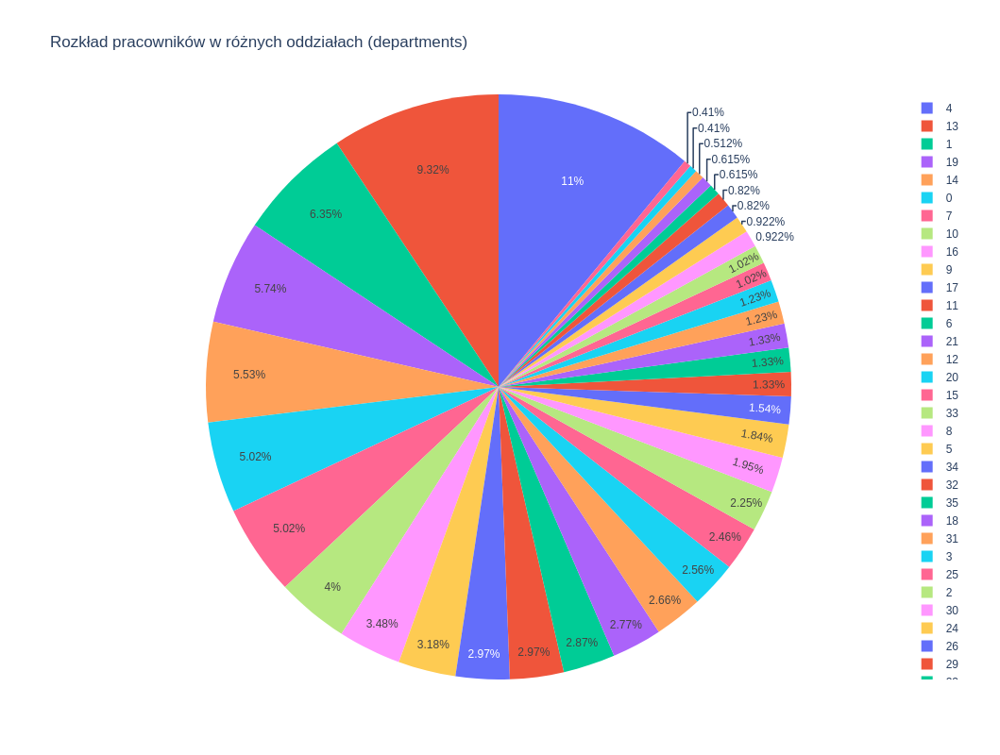

In [51]:
fig = px.pie(
    departments_count_df,
    values="count",
    names="department_id",
    color="department_id",
    width=800,
    height=800,
    title='Rozkład pracowników w różnych oddziałach (departments)',
)
fig 

### Dane o relacjach między użytkownikami

In [18]:
def simplify_dataset(df: pd.DataFrame) -> pd.DataFrame:
    simp_df = df[df['from'] != df['to']]  # remove cycles
    return simp_df

In [19]:
members_df.drop_duplicates()

,from,to
0,0,1
1,2,3
2,2,4
3,5,6
4,5,7
...,...,...
25566,420,143
25567,174,859
25568,440,460
25569,52,786


W zbiorze nie ma duplikatów.

In [20]:
def message_intensity(df: pd.DataFrame, all_users: list):
    results = np.zeros((max(all_users) + 1, max(all_users) + 1), dtype=np.float32)
    for id_from in all_users:
        messages_from = list(df[df["from"] == id_from]["to"])
        for id_to in messages_from: 
            results[id_from][id_to] += 1
    return results

In [21]:
messages = message_intensity(members_df, all_users)

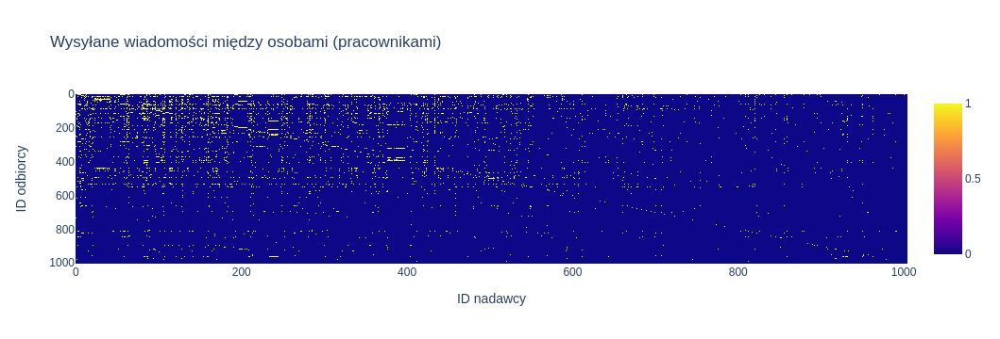

<Figure size 1800x3600 with 0 Axes>

In [22]:
fig = plt.figure(1, figsize=(30, 60), dpi=60)
fig = px.imshow(
    messages, 
    title="Wysyłane wiadomości między osobami (pracownikami)",
    labels=dict(x="ID nadawcy", y="ID odbiorcy"),
    aspect='auto'
)
fig.show()

Na podstawie powyższej macierzy widać nierównomierne zagęszczenie wysyłanych wiadomości. Najwięcej się dzieje w przybliżonym obszarze oscylującym do `ID = 600`. Zatem można przypuszczać, że użytkownicy z id większym niż 600 komunikują się rzadziej.

In [23]:
members_df[members_df['from'] == members_df['to']]

,from,to
44,54,54
117,137,137
121,143,143
129,150,150
157,123,123
...,...,...
25112,474,474
25166,777,777
25237,833,833
25299,212,212


Istnieje sporo pętli w zbiorze - tj użytkowników którzy wysyłali wiadomości do samych siebie. Na potrzeby badań, rekordy te zostaną usunięte.

In [24]:
members_df = simplify_dataset(members_df)
members_df

,from,to
0,0,1
1,2,3
2,2,4
3,5,6
4,5,7
...,...,...
25566,420,143
25567,174,859
25568,440,460
25569,52,786


In [25]:
all_users = list(set(list(members_df["from"]) + list(members_df["to"])))
len(labels_df["user_id"]) - len(all_users)

19

Widać że 19 użytkowników było w relacji tylko z samym sobą. 

In [26]:
senders = members_df["from"].value_counts().reset_index()
senders = senders.rename(columns={"index": "id", "from": "count"})
senders

,id,count
0,160,331
1,82,224
2,121,219
3,107,202
4,86,198
...,...,...
811,276,1
812,228,1
813,846,1
814,995,1


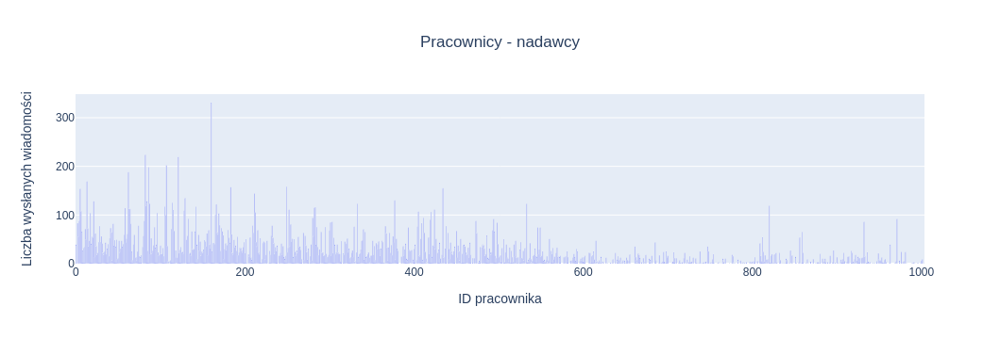

In [27]:
fig = px.bar(
    senders.sort_values(by="id"),
    x="id",
    y="count",
    labels={
        "id": "ID pracownika",
        "count": "Liczba wysłanych wiadomości",
    },
    title="Pracownicy - nadawcy"
)
fig.update_layout(title_x=0.5)
fig.show()

In [28]:
receivers = members_df["to"].value_counts().reset_index()
receivers = receivers.rename(columns={"index": "id", "to": "count"})
receivers

,id,count
0,160,209
1,62,177
2,107,167
3,121,155
4,86,150
...,...,...
951,606,1
952,920,1
953,904,1
954,888,1


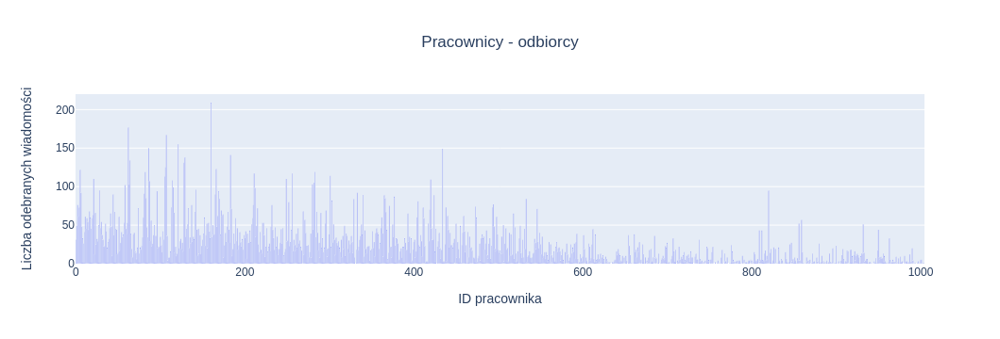

In [29]:
fig = px.bar(
    receivers.sort_values(by="id"),
    x="id",
    y="count",
    labels={
        "id": "ID pracownika",
        "count": "Liczba odebranych wiadomości",
    },
    title="Pracownicy - odbiorcy"
)
fig.update_layout(title_x=0.5)
fig.show()

In [30]:
receivers_diff = list(set(all_users) - set(receivers["id"]))
pd.DataFrame(receivers_diff, columns=["user_id"])

,user_id
0,773
1,901
2,524
3,788
4,790
5,802
6,943
7,944
8,846
9,979


In [31]:
senders_diff = list(set(all_users) - set(senders["id"]))
pd.DataFrame(senders_diff, columns=["user_id"])

,user_id
0,1
1,532
2,561
3,571
4,574
...,...
155,997
156,998
157,1002
158,1004


In [32]:
set(senders_diff).intersection(receivers_diff)

set()

19 użytkowników nie otrzymuje żadnych wiadomości. Z kolei aż 160 nie wysyła żadnych wiadomości.

Potwierdzony został fakt, że każda osoba w zbiorze ma przypisaną przynajmniej jedną aktywność. Tworzona sieć będzie spójna.

In [33]:
labels_df = labels_df[labels_df["user_id"].isin(all_users)].reset_index(drop=True)

In [34]:
labels_df

,user_id,department_id
0,0,1
1,1,1
2,2,19
3,3,19
4,4,19
...,...,...
971,1000,4
972,1001,19
973,1002,1
974,1003,6


In [49]:
labels_df.department_id.sort_values().unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36])

In [48]:
labels_df

,user_id,department_id
0,0,1
1,1,1
2,2,19
3,3,19
4,4,19
...,...,...
971,1000,4
972,1001,19
973,1002,1
974,1003,6


In [47]:
labels_df.to_csv(DATA_DIR / "labels_undirected.tsv", sep=" ", index=False)

## Analiza sieci społecznościowej

Zbiór odzwierciedla sieć w postaci grafu skierowanego. Na potrzeby zadania założymy, że graf jest nieskierowany, tj. jeśli osoba $x$ wysłała wiadomość do osoby $y$ to zakładamy że są one w relacji obustronnej. Takie założenie wymaga dodatkowego wyczyszczenia danych.

In [37]:
def modify_dataset(df: pd.DataFrame) -> pd.DataFrame:

    data = {
        "from": [],
        "to": []
    }
    
    checked = []
    
    for id_, row in df.iterrows():
        
        check_id = f"{row['from']}_{row['to']}" 
        check_id_reversed = f"{row['to']}_{row['from']}" 

        if not check_id in checked:
            data["from"].append(row["from"])
            data["to"].append(row["to"])
            checked.append(check_id)
            checked.append(check_id_reversed)
            
        if not check_id_reversed in checked: 
            data["from"].append(row["to"])
            data["to"].append(row["from"])
            checked.append(check_id_reversed)
    
    return pd.DataFrame(data)

In [38]:
def print_graph_summary(g: nx.Graph):
    print(f"""
        Liczba wierzchołków: {g.number_of_nodes()}
        Liczba krawędzi: {g.number_of_edges()}
        Graf skierowany: {nx.is_directed(g)}   
        Lista atrybutów: {g.nodes[0].keys()}
    """)

In [39]:
undirected_df = modify_dataset(members_df)

In [40]:
undirected_df

,from,to
0,0,1
1,2,3
2,2,4
3,5,6
4,5,7
...,...,...
15866,121,458
15867,420,28
15868,87,227
15869,420,143


In [41]:
undirected_df.to_csv(DATA_DIR / "members_undirected.tsv", sep=" ", index=False)

In [42]:
G = nx.from_pandas_edgelist(
    undirected_df,
    "from",
    "to"
)
nx.set_node_attributes(
    G,
    {id_: value for id_, value in zip(labels_df["user_id"], labels_df["department_id"])},
    name="department_id"
)
colors = np.random.rand(42, 3) # 42 is old number of departments

In [43]:
print_graph_summary(G)


        Liczba wierzchołków: 976
        Liczba krawędzi: 15871
        Graf skierowany: False   
        Lista atrybutów: dict_keys(['department_id'])
    


## Wizualizacja sieci

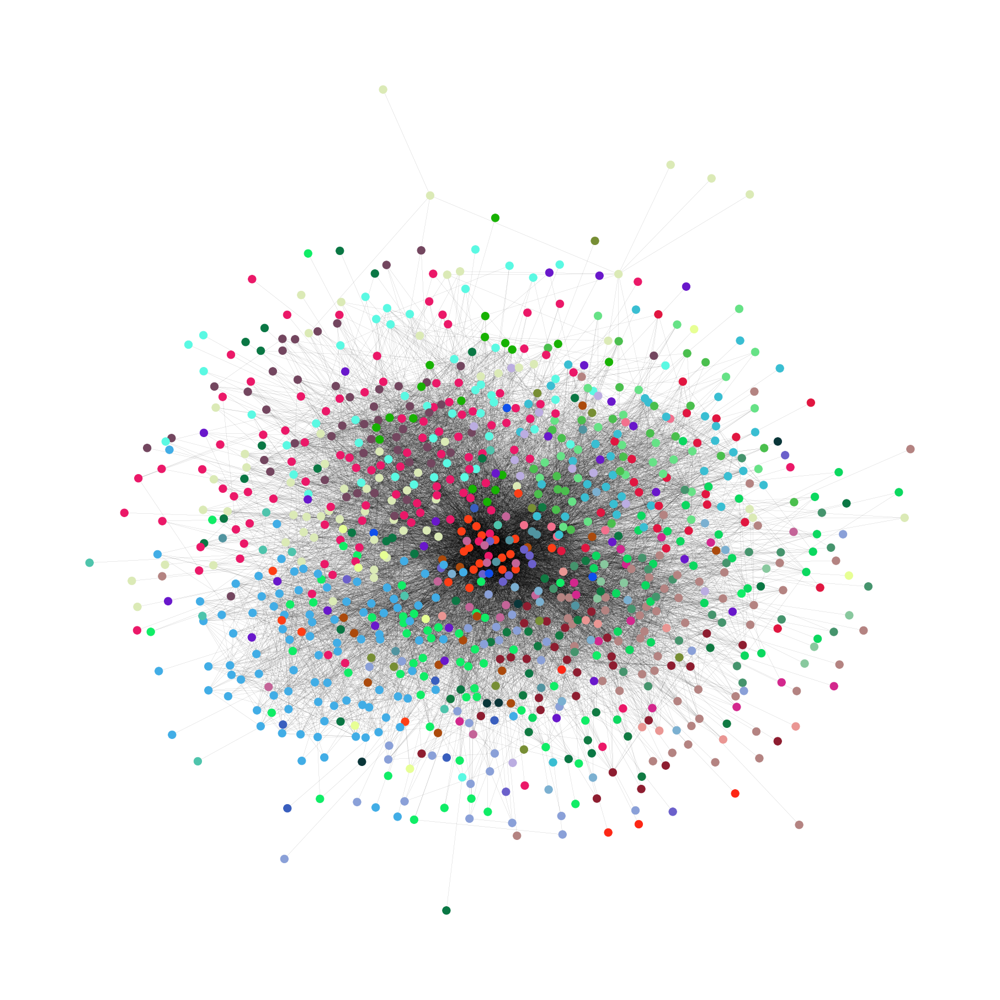

In [44]:
fig = plt.figure(1, figsize=(30, 30), dpi=60)
pos = nx.kamada_kawai_layout(G)
nx.draw(
    G,
    pos=pos,
    nodelist=list(G.nodes),
    node_color=[colors[node] for node in nx.get_node_attributes(G, "department_id").values()],
    width=0.1
)
fig.savefig(IMAGES_PATH / "network.png")

In [ ]:
Num_nodes = len(G.nodes)
edges = G.edges()

# ## update to 3d dimension
spring_3D = nx.random_layout(G, dim = 3) # k regulates the distance between nodes

x_nodes= [spring_3D[key][0] for key in spring_3D.keys()] # x-coordinates of nodes
y_nodes = [spring_3D[key][1] for key in spring_3D.keys()] # y-coordinates
z_nodes = [spring_3D[key][2] for key in spring_3D.keys()] # z-coordinates

#we need to create lists that contain the starting and ending coordinates of each edge.
x_edges=[]
y_edges=[]
z_edges=[]

#need to fill these with all of the coordinates
for edge in edges:

    x_coords = [spring_3D[edge[0]][0],spring_3D[edge[1]][0],None]
    x_edges += x_coords

    y_coords = [spring_3D[edge[0]][1],spring_3D[edge[1]][1],None]
    y_edges += y_coords

    z_coords = [spring_3D[edge[0]][2],spring_3D[edge[1]][2],None]
    z_edges += z_coords


#create a trace for the edges
trace_edges = go.Scatter3d(
    x=x_edges,
    y=y_edges,
    z=z_edges,
    mode='lines',
    line=dict(color='black', width=0.1),
    hoverinfo='none'
)

#create a trace for the nodes
trace_nodes = go.Scatter3d(
    x=x_nodes,
    y=y_nodes,
    z=z_nodes,
    mode='markers',
    marker=dict(
        symbol='circle',
        size=2,
        color=[colors[node] for node in nx.get_node_attributes(G, "department_id").values()],
    )
)

#Include the traces we want to plot and create a figure
data = [trace_edges, trace_nodes]
fig = go.Figure(data=data)
fig.update_layout(
    autosize=False,
    width=1600,
    height=1600,
)
fig.show()

In [46]:
nx.write_gpickle(G, DATA_DIR / 'network.gpickle')